# Set-up
* Download and store this notebook in you Google drive.
* Change the working folder to the folder where your downloaded notbook is.
* Open the stored notebook.

## Import Packages

In [1]:
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

# Retrieve POIs data
import requests
import json

# Geospatial analysis
import geopandas as gpd
import libpysal
import esda

# Spatial Weights
from libpysal.weights import Queen, Rook, KNN, Kernel
from pysal.lib import weights
import shapely

# Walkshed with road network
import osmnx as ox
import networkx as nx
from shapely.geometry import Point
from alphashape import alphashape

# NDVI Calculation
import rasterio
import rasterstats as rstats
from rasterio.plot import show

# Plotting
import folium
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import contextily as ctx
from splot import esda as esdaplot
from folium import plugins
%matplotlib inline


# 1. Geographical V.S. Projected Coordinate Systems
* Commonly-used Coordinate System for D.C.:
    * https://octo.dc.gov/page/coordinate-system-standards
    * https://epsg.io/6487
* Data source: https://www2.census.gov/geo/tiger/TIGER2020/TRACT/

In [2]:
# read census tract boundary in DC
dc_census_tract = gpd.read_file("https://www2.census.gov/geo/tiger/TIGER2020/TRACT/tl_2020_11_tract.zip")

In [3]:
# Check the coordinate system of `dc_census_tract`
dc_census_tract.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

In [4]:
# Reproject the D.C. boundary data to the projected coordinate system "MD State Plane NAD 83"
dc_census_tract_rprj = dc_census_tract.to_crs("EPSG:6487")

In [5]:
dc_census_tract_rprj.crs

<Projected CRS: EPSG:6487>
Name: NAD83(2011) / Maryland
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: United States (USA) - Maryland - counties of Allegany; Anne Arundel; Baltimore; Calvert; Caroline; Carroll; Cecil; Charles; Dorchester; Frederick; Garrett; Harford; Howard; Kent; Montgomery; Prince Georges; Queen Annes; Somerset; St Marys; Talbot; Washington; Wicomico; Worcester.
- bounds: (-79.49, 37.97, -74.97, 39.73)
Coordinate Operation:
- name: SPCS83 Maryland zone (meters)
- method: Lambert Conic Conformal (2SP)
Datum: NAD83 (National Spatial Reference System 2011)
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

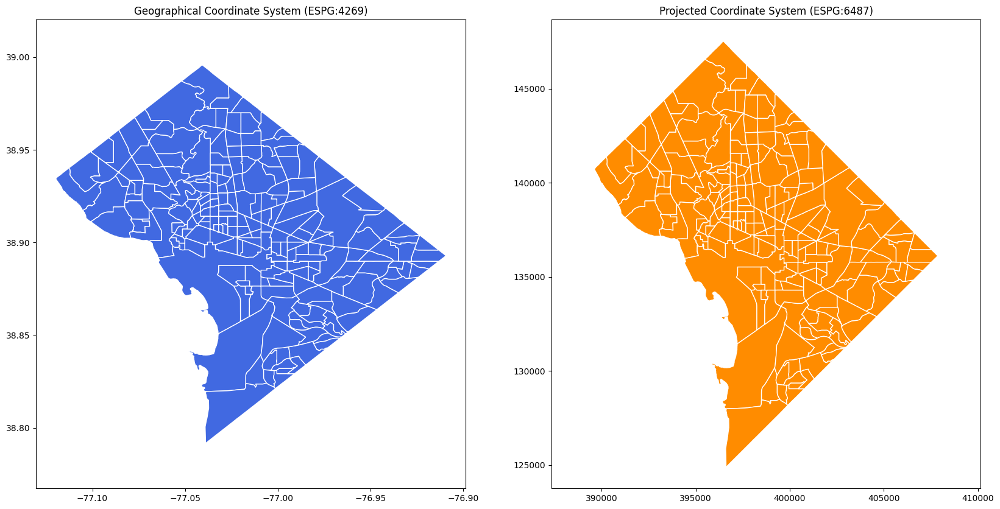

In [6]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))

# Plot the original coordinate system
dc_census_tract.plot(ax=ax1, color='royalblue', edgecolor='white')
ax1.set_title('Geographical Coordinate System (ESPG:4269)')
ax1.axis('equal')

# Plot the reprojected coordinate system
dc_census_tract_rprj.plot(ax=ax2, color='darkorange', edgecolor='white')
ax2.set_title('Projected Coordinate System (ESPG:6487)')
ax2.axis('equal')

plt.show()

# 2. Eateries in D.C.

## Retrive POIs in D.C.

In [7]:
# Get the bounding box of D.C.
print(dc_census_tract.total_bounds)

[-77.119759  38.791645 -76.909393  38.995845]


In [8]:
# Define the bboxing of Washington, D.C. for POIs query using overpass API
dc_bbox = "38.791645, -77.119759, 38.995845, -76.909393"

In [9]:
# Define the Overpass API URL
overpass_url = "http://overpass-api.de/api/interpreter"

# Define the Overpass query using the bounding box variable
dc_eatery_overpass_query = f"""
[out:json][timeout:25];

(
  node["amenity"="restaurant"]({dc_bbox});
  node["amenity"="cafe"]({dc_bbox});
  node["amenity"="bar"]({dc_bbox});
  node["amenity"="biergarten"]({dc_bbox});
  node["amenity"="pub"]({dc_bbox});

);
out body;
>;
out skel qt;
"""

# Make the request
dc_eatery_response = requests.get(overpass_url, params={'data': dc_eatery_overpass_query})
dc_eatery_dict = dc_eatery_response.json()

# Convert the data into a pandas DataFrame
dc_eatery_list = [] # Create a list for the initilization of the dataframe
for element in dc_eatery_dict['elements']:
    uid = element['id']
    latitude = element['lat']
    longitude = element['lon']
    name = element.get('tags', {}).get('name', 'n/a')
    amenity = element.get('tags', {}).get('amenity', 'n/a')
    dc_eatery_list.append({
        'UID': uid,
        'Name': name,
        'Type': amenity,
        'Latitude': latitude,
        'Longitude': longitude
    })

# Create the DataFrame using the list
dc_eatery_df = pd.DataFrame(dc_eatery_list)

# Show the DataFrame
dc_eatery_df

,UID,Name,Type,Latitude,Longitude
0,60471261,Cafe Saint Ex,bar,38.915421,-77.031701
1,388247153,Millie’s,restaurant,38.945050,-77.096330
2,419267705,Buzz Bakeshop,cafe,38.821596,-77.047646
3,459806171,Euro Market,cafe,38.891441,-77.086067
4,460211089,Mamma Lucia,restaurant,38.990991,-77.029690
...,...,...,...,...,...
2294,11333728035,n/a,restaurant,38.883767,-77.024932
2295,11342018268,Tatte,cafe,38.901165,-77.038840
2296,11345449272,Nama,restaurant,38.902765,-77.018308
2297,11345449273,Rasa,restaurant,38.902772,-77.018442


## Aggregate POIs into Each Census Tract in D.C.

In [10]:
# Create a GeoDataFrame for `dc_eatery_df`
dc_eatery_gdf = gpd.GeoDataFrame(dc_eatery_df.copy(), geometry=gpd.points_from_xy(dc_eatery_df.Longitude, dc_eatery_df.Latitude), crs = dc_census_tract.crs)

# Reproject the `dc_eatery_gdf` to match the CRS of the `dc_census_tract_rprj` GeoDataFrame
dc_eatery_gdf_rprj = dc_eatery_gdf.to_crs(dc_census_tract_rprj.crs)

# Perform a spatial join between the reprojected eatery points and the census tracts.
# This assigns each eatery to a census tract if it is within the tract's boundaries.
dc_eatery = gpd.sjoin(dc_eatery_gdf_rprj, dc_census_tract_rprj, predicate='within', how='inner').reset_index(drop = True)
dc_ct_eatery = dc_eatery.assign(count = np.ones(dc_eatery.shape[0]))
dc_ct_eatery = dc_ct_eatery.groupby('GEOID')['count'].sum().reset_index()

# Merge the eatery counts with the census tracts GeoDataFrame
dc_ct_eatery = dc_census_tract_rprj.merge(dc_ct_eatery, on='GEOID', how='left')

# Replace NaN values with 0 for tracts without eatery
dc_ct_eatery['count'] = dc_ct_eatery['count'].fillna(0)

# Rename the 'count' column to 'eatery_count'
dc_ct_eatery.rename(columns={'count': 'eatery_count'}, inplace=True)

<Axes: >

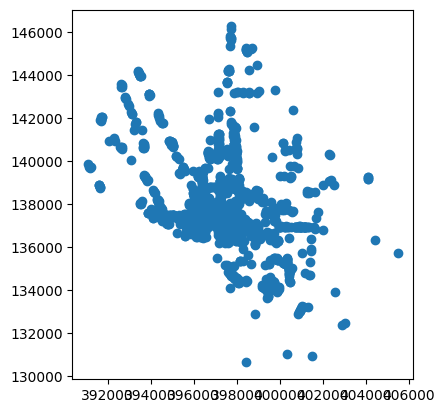

In [11]:
dc_eatery.plot()

## Density of Eateries by Census Tracts

In [12]:
# Calculate the area of each census tract in D.C.
dc_ct_eatery = dc_ct_eatery.assign(area_km2 = dc_ct_eatery.geometry.area/1e6)

In [13]:
# Create the column 'eatery_density' in 'dc_ct_eatery'
dc_ct_eatery = dc_ct_eatery.assign(eatery_density = dc_ct_eatery.eatery_count/dc_ct_eatery.area_km2)

## Visualization

In [14]:
dc_ct_eatery_geog = dc_ct_eatery.to_crs(dc_census_tract.crs)
dc_eatery_geog = dc_eatery.to_crs(dc_census_tract.crs)

# Create a colormap and normalizer for the unique types of eateries
unique_types = dc_eatery_geog.Type.unique()
cmap = matplotlib.cm.get_cmap('tab10', len(unique_types))  # 'tab10' is a good discrete colormap for categorical data
norm = matplotlib.colors.Normalize(vmin=0, vmax=len(unique_types) - 1)

# Initialize the map centered around Washington D.C.
m = folium.Map(location=[38.9072, -77.0369], zoom_start=12, tiles='CartoDB Positron')

# Add the census tracts to the map with color based on 'eatery_density'
folium.Choropleth(
    geo_data=dc_ct_eatery_geog.to_json(),
    name='Census Tracts',
    data=dc_ct_eatery_geog,
    columns=['GEOID', 'eatery_density'],
    key_on='feature.properties.GEOID',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Eatery Density by Census Tracts'
).add_to(m)

# Create a feature group for each unique type of eatery
feature_groups = {}
for eatery_type in unique_types:
    feature_group = folium.FeatureGroup(name=str(eatery_type))
    feature_groups[eatery_type] = feature_group
    feature_group.add_to(m)

# Add the eateries to their respective feature group
for _, row in dc_eatery_geog.iterrows():
    eatery_type = row['Type']
    color = matplotlib.colors.to_hex(cmap(norm(unique_types.tolist().index(eatery_type))))
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        color=color,
        radius=1.5,
        fill=True,
        fill_color=color,
        fill_opacity=0.7
    ).add_to(feature_groups[eatery_type])

# Add the layer control to toggle feature groups
folium.LayerControl().add_to(m)

# Display the map
m  # If you're using a Jupyter notebook, this will display the map inline.


# Spatial Weights

Spatial weights are mathematical structures used to represent spatial relationships. Many spatial analytics, such as spatial autocorrelation statistics and regionalization algorithms rely on spatial weights. Generally speaking, a spatial weight 𝑤𝑖,𝑗 expresses the notion of a geographical relationship between locations 𝑖 and 𝑗 . These relationships can be based on a number of criteria including contiguity, geospatial distance and general distances.

In [15]:
dc_census_block = gpd.read_file("https://www2.census.gov/geo/tiger/TIGER2020/BG/tl_2020_11_bg.zip")

dc_census_block.head()

,STATEFP,COUNTYFP,TRACTCE,BLKGRPCE,GEOID,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,11,001,010800,1,110010108001,Block Group 1,G5030,S,112810,0,+38.9005669,-077.0474728,"POLYGON ((-77.05014 38.90033, -77.05013 38.900..."
1,11,001,010900,2,110010109002,Block Group 2,G5030,S,2270174,2933566,+38.8132364,-077.0238475,"POLYGON ((-77.03919 38.80050, -77.03913 38.800..."
2,11,001,007401,1,110010074011,Block Group 1,G5030,S,1029053,200980,+38.8668098,-076.9949201,"POLYGON ((-77.00540 38.86879, -77.00341 38.870..."
3,11,001,007403,1,110010074031,Block Group 1,G5030,S,126738,0,+38.8481009,-076.9774095,"POLYGON ((-76.98127 38.84662, -76.98098 38.846..."
4,11,001,007404,1,110010074041,Block Group 1,G5030,S,360630,0,+38.8514546,-076.9784997,"POLYGON ((-76.98334 38.85337, -76.98277 38.853..."


Reprojecting to PCS

In [16]:
rprj_dc= dc_census_block.to_crs('26985')

##Type of Weights

###Contiguity based weights



Queen Weights

A commonly-used type of weight is a queen contigutiy weight, which reflects adjacency relationships as a binary indicator variable denoting whether or not a polygon shares an edge or a vertex with another polygon. These weights are symmetric, in that when polygon 𝐴 neighbors polygon 𝐵, both 𝑤𝐴𝐵=1 and 𝑤𝐵𝐴=1.

In [17]:
qW = Queen.from_dataframe(rprj_dc)

All weights objects have a few traits that you can use to work with the weights object, as well as to get information about the weights object.

To get the neighbors & weights around an observation, use the observation's index on the weights object, like a dictionary:

In [18]:
qW[20]

{496: 1.0, 21: 1.0, 554: 1.0, 555: 1.0, 557: 1.0}

By default, the weights and the pandas dataframe will use the same index. So, we can view the observation and its neighbors in the dataframe by putting the observation's index and its neighbors' indexes together in one list:

In [19]:
self_and_neighbors = [20]
self_and_neighbors.extend(qW.neighbors[20])
print(self_and_neighbors)

[20, 496, 21, 554, 555, 557]


In [20]:
rprj_dc.loc[self_and_neighbors]

,STATEFP,COUNTYFP,TRACTCE,BLKGRPCE,GEOID,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
20,11,001,007809,1,110010078091,Block Group 1,G5030,S,255912,0,+38.9017541,-076.9278893,"POLYGON ((405927.041 137245.539, 405942.912 13..."
496,11,001,007804,1,110010078041,Block Group 1,G5030,S,270528,4302,+38.8985775,-076.9350753,"POLYGON ((405274.849 136844.450, 405275.001 13..."
21,11,001,007809,2,110010078092,Block Group 2,G5030,S,279342,0,+38.9013442,-076.9361406,"POLYGON ((404989.104 137132.774, 405013.029 13..."
554,11,001,007806,1,110010078061,Block Group 1,G5030,S,294019,0,+38.9059712,-076.9290685,"POLYGON ((405804.287 137979.101, 405823.616 13..."
555,11,001,007806,2,110010078062,Block Group 2,G5030,S,377415,0,+38.9052976,-076.9352658,"POLYGON ((404956.402 137133.864, 405001.479 13..."
557,11,001,007807,2,110010078072,Block Group 2,G5030,S,281391,0,+38.8991961,-076.9232083,"POLYGON ((406396.272 136535.897, 406407.342 13..."


Since weight matrices are typically very sparse, there is also a sparse weights matrix constructor:

In [21]:
qW.sparse

<571x571 sparse matrix of type '<class 'numpy.float64'>'
	with 3618 stored elements in Compressed Sparse Row format>

<Axes: >

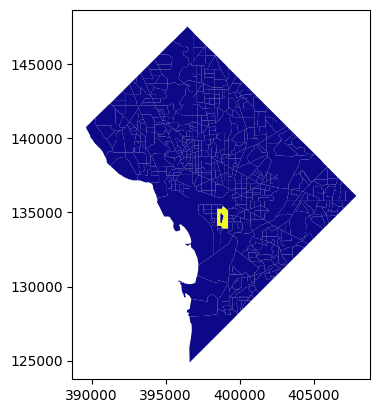

In [22]:
rprj_dc.assign(weights = qW.sparse[100,:].toarray().flatten()).plot('weights', cmap='plasma')

Note: We can work with the reprojected file as well in order to avoid warnings for using GCS.

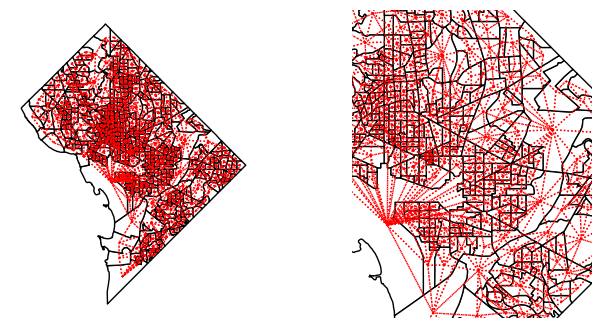

In [23]:
f, axs = plt.subplots(1, 2, figsize=(8, 4))

for i in range(2):
    ax = dc_census_block.plot(
        edgecolor="k", facecolor="w", ax=axs[i]
    )

    # Plot graph connections
    qW.plot(
        dc_census_block,
        ax=axs[i],
        edge_kws=dict(color="r", linestyle=":", linewidth=1),
        node_kws=dict(marker=""),
    )

    # Remove the axis
    axs[i].set_axis_off()

# Adjust the limits for the second subplot if needed
axs[1].axis([-77.05, -76.95, 38.85, 38.95])
plt.show()

Rook Weights

Rook weights are another type of contiguity weight, but consider observations as neighboring only when they share an edge. The rook neighbors of an observation may be different than its queen neighbors, depending on how the observation and its nearby polygons are configured.

In [24]:
rW = weights.Rook.from_dataframe(rprj_dc)


0.9041807625421343


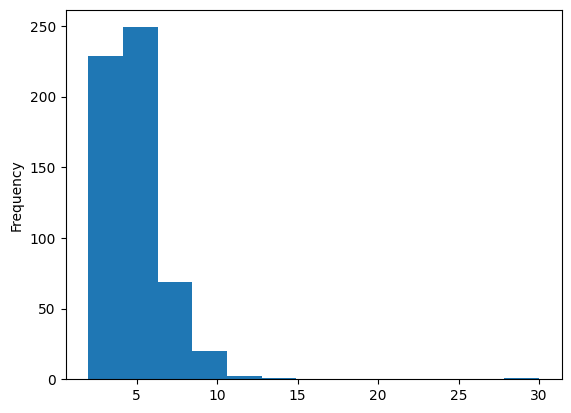

In [25]:
print(rW.pct_nonzero)
s = pd.Series(rW.cardinalities)
s.plot.hist(bins=s.unique().shape[0]);

###Distance based weights



In addition to contiguity, we can also define neighbor relations as a function of the distance separating spatial observations. Usually, this means that a matrix expressing the distances between all pairs of observations are required. These are then provided to a kernel function which uses the proximity information to model proximity as a smooth function of distance.

K-nearest neighbor weights

In [26]:
dc_knn8 = weights.KNN.from_dataframe(rprj_dc, k=8)

Kernel weights

Kernel weights are one of the most commonly-used kinds of distance weights. They reflect the case where similarity/spatial proximity is assumed or expected to decay with distance. The essence of kernel weights is that the weight between observations and is based on their distance, but it is further modulated by a kernel function with certain properties.

<Axes: >

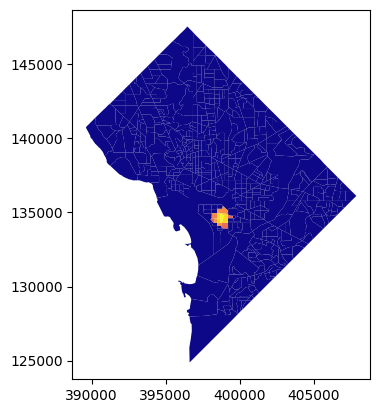

In [27]:
kernelWa = Kernel.from_dataframe(rprj_dc, k=10, fixed=False, function='gaussian')
rprj_dc.assign(weights =
          kernelWa.sparse[100,:].toarray().flatten()).plot('weights',
                                                           cmap='plasma')

In [28]:
kernelWa.bandwidth

array([[ 651.65311129],
       [2931.17715607],
       [1257.48439854],
       [ 887.09543331],
       [ 909.40781872],
       [ 920.62155692],
       [ 791.47888846],
       [ 958.39277578],
       [1006.07499259],
       [1065.99219576],
       [1199.91593645],
       [ 708.48840458],
       [ 847.9876402 ],
       [ 784.03154511],
       [ 674.97714889],
       [ 859.73160127],
       [ 959.40572672],
       [1232.55454774],
       [ 892.71401233],
       [ 911.01349332],
       [1179.47773298],
       [1133.47388601],
       [ 726.52662911],
       [ 709.96582709],
       [ 933.799038  ],
       [ 671.45212795],
       [ 738.57541011],
       [ 667.85920227],
       [ 614.78846091],
       [ 615.91545113],
       [1563.02285283],
       [1950.98796822],
       [1698.19090709],
       [1357.59543689],
       [ 683.63771717],
       [1289.8043173 ],
       [1099.72148693],
       [ 708.53102485],
       [ 750.6016547 ],
       [ 705.08946773],
       [ 881.86046463],
       [1025.548

<Axes: >

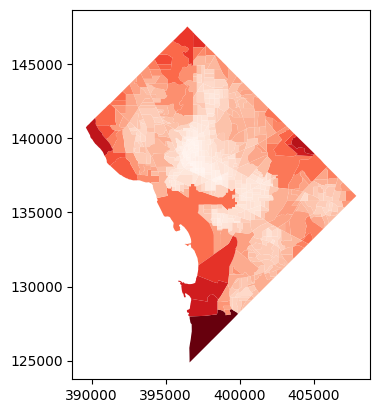

In [29]:
rprj_dc.assign(bw=kernelWa.bandwidth.flatten()).plot('bw', cmap='Reds')

fixed bandwidths for the map and weight according to a gaussian kernel

bandwidth = maximum of (the distances to the kth nearest neighbor for all observations)

<Axes: >

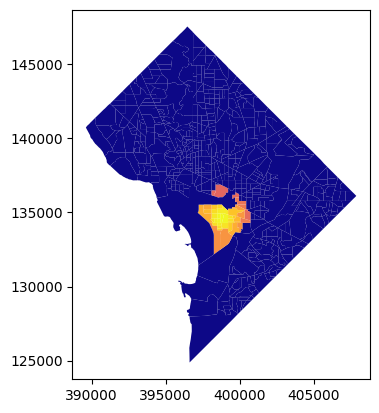

In [30]:
kernelWa = Kernel.from_dataframe(rprj_dc, k=2, fixed=True, function='gaussian')

rprj_dc.assign(weights=kernelWa.sparse[100,:].toarray().flatten()).plot('weights', cmap='plasma')

###Block weights

Block weights connect every observation in a dataset that belongs to the same category in a provided list. In essence, a block weight structure groups individual observations and considers all members of the group as “near” one another. This means that they then have a value of one for every pair of observations in the same group. Contrariwise, all members not in that group are considered disconnected from any observation within the group, and given a value of zero. This is done for every group, so the resulting matrix looks like “blocks” of 1s stacked on the diagonal (assuming that observations in the same group are near one another in the input data table), hence the “block” weights.

In [31]:
w,s,e,n = rprj_dc.total_bounds

In [32]:
dx = (w+e)/2
dy = (n+s)/2

In [33]:
centroids = rprj_dc.geometry.centroid

In [34]:
lon = centroids.apply(lambda p: p.x).values
lat = centroids.apply(lambda p: p.y).values

In [35]:
north = lat > dy
south = lat <= dy
east = lon > dx
west = lon <= dx

In [36]:
nw = west * north * 2
ne = east * north * 1
sw = west * south * 3
se = east * south *4
quad = nw + ne + sw + se
quad

array([2, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4, 2, 2, 4, 2, 1, 4, 1, 1,
       1, 1, 1, 1, 4, 4, 1, 4, 1, 1, 1, 1, 4, 1, 4, 1, 1, 1, 4, 2, 2, 2,
       2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 4, 2, 2, 2, 4, 4, 2, 2, 1,
       4, 2, 1, 1, 2, 4, 4, 2, 4, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3,
       1, 1, 1, 1, 1, 4, 3, 3, 3, 3, 3, 3, 4, 3, 4, 1, 4, 4, 4, 4, 4, 4,
       4, 4, 1, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 3, 3, 2, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       4, 2, 2, 3, 3, 4, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4,
       2, 3, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 4, 2, 4, 1, 1, 4, 2, 2,
       2, 2, 4, 4, 1, 4, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 2, 2, 1, 1,
       1, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 1, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 4, 3, 4, 1, 1, 1, 4,
       2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,

Reprojected DC blocks

<Axes: >

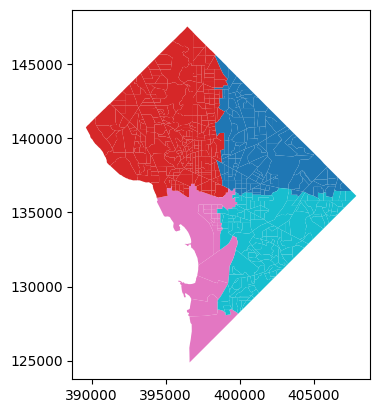

In [37]:
rprj_dc['quad'] = quad
rprj_dc.plot(column="quad", categorical=True)

In [38]:
dx_bw = weights.util.block_weights(rprj_dc["quad"].values)



##Visualizing weight set operations



Comparison of neighbor graphs that results from some of the criteria introduced to define neighbor relations.

Text(0.5, 1.0, 'Block weights')

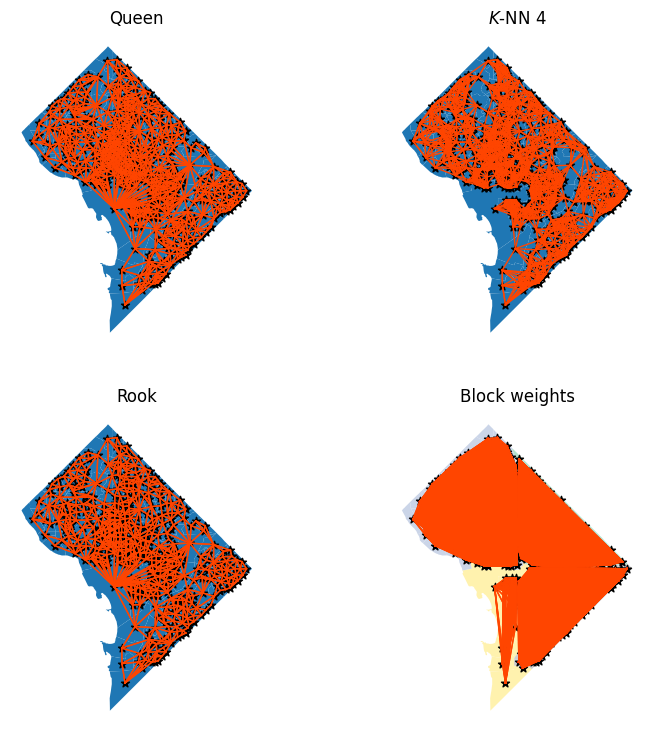

In [39]:
# Set up figure and axis
f, axs = plt.subplots(2, 2, figsize=(9, 9))

# Contiguity
ax = axs[0, 0]
rprj_dc.plot(ax=ax)
qW.plot(
    rprj_dc,
    edge_kws=dict(linewidth=1, color="orangered"),
    node_kws=dict(marker="*"),
    ax=ax,
)
ax.set_axis_off()
ax.set_title("Queen")

# KNN
ax = axs[0, 1]
rprj_dc.plot(ax=ax)
dc_knn8.plot(
    rprj_dc,
    edge_kws=dict(linewidth=1, color="orangered"),
    node_kws=dict(marker="*"),
    ax=ax,
)
ax.set_axis_off()
ax.set_title("$K$-NN 4")

# RW
ax = axs[1, 0]
rprj_dc.plot(ax=ax)
rW.plot(
    rprj_dc,
    edge_kws=dict(linewidth=1, color="orangered"),
    node_kws=dict(marker="*"),
    ax=ax,
)
ax.set_axis_off()
ax.set_title("Rook")

# Block
ax = axs[1, 1]
rprj_dc.plot(column="quad", categorical=True, cmap="Pastel2", ax=ax)
dx_bw.plot(
    rprj_dc,
    edge_kws=dict(linewidth=1, color="orangered"),
    node_kws=dict(marker="*"),
    ax=ax,
)
ax.set_axis_off()
ax.set_title("Block weights")


##Visualization of blocks and their neighbours based on Queen, Rook, KNN

For the visualization part we are going to use the DC shapefile in GCS

In [40]:
def style_function(feature):
    return {
        'fillColor': 'orange',
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.7
    }

# Define a highlight function to set the color on hover
def highlight_function(feature):
    return {
        'fillColor': 'red',  # Color for the hovered block
        'color': 'black',
        'weight': 2,
        'fillOpacity': 0.7
    }

In [41]:
dc_census_block['queen_neighbors'] = [qW.neighbors[idx] for idx in dc_census_block.index]
dc_census_block['rook_neighbors'] = [rW.neighbors[idx] for idx in dc_census_block.index]
dc_census_block['knn_neighbors'] = [dc_knn8.neighbors[idx] for idx in dc_census_block.index]

In [42]:
dc_census_block['queen_neighbors'] = dc_census_block['queen_neighbors'].astype(str)
dc_census_block['rook_neighbors'] = dc_census_block['rook_neighbors'].astype(str)
dc_census_block['knn_neighbors'] = dc_census_block['knn_neighbors'].astype(str)

In [43]:

# Create a folium map centered around DC
dc_map = folium.Map(location=[dc_census_block.geometry.centroid.y.mean(), dc_census_block.geometry.centroid.x.mean()], zoom_start=11)

# Add the GeoJson layer for the blocks with Queen, Rook, and KNN neighbors information
folium.GeoJson(dc_census_block, name='geojson',
               #style_function=lambda x: {'fillColor': 'orange'},
               style_function=style_function,
               highlight_function=highlight_function,
               tooltip=folium.features.GeoJsonTooltip(
                   fields=['GEOID', 'queen_neighbors', 'rook_neighbors', 'knn_neighbors'],
                   aliases=['Block ID', 'Queen Neighbors', 'Rook Neighbors', 'KNN Neighbors'],
                   sticky=True,
                   localize=True,
                   labels=True,
                   style="font-weight: bold;",
                   highlight= True
               )).add_to(dc_map)

# Save the map to an HTML file
dc_map.save("dc_map_with_neighbors.html")

In [44]:
dc_map

# Hotspot Analysis in D.C.
* Data source: https://opendata.dc.gov/datasets/DCGIS::crime-incidents-in-the-last-30-days/about

## Read Data and Process Data [Recap]

In [45]:
# read crime incidents in D.C.
dc_crime = gpd.read_file("https://opendata.dc.gov/datasets/DCGIS::crime-incidents-in-the-last-30-days.geojson")

In [46]:
dc_crime.head()


,CCN,REPORT_DAT,SHIFT,METHOD,OFFENSE,BLOCK,XBLOCK,YBLOCK,WARD,ANC,...,CENSUS_TRACT,VOTING_PRECINCT,LATITUDE,LONGITUDE,BID,START_DATE,END_DATE,OBJECTID,OCTO_RECORD_ID,geometry
0,23169311,2023-10-14 04:24:51+00:00,MIDNIGHT,OTHERS,THEFT/OTHER,1400 - 1499 BLOCK OF P STREET NW,397115.780000,137977.230000,2,2F,...,005203,Precinct 16,38.909652,-77.033254,None,2023-10-14 03:13:00+00:00,2023-10-14 03:15:00+00:00,427423372,None,POINT (-77.03326 38.90966)
1,23169743,2023-10-15 00:50:52+00:00,EVENING,OTHERS,MOTOR VEHICLE THEFT,1200 - 1399 BLOCK OF DELAWARE AVENUE SW,398747.163005,134091.609114,6,6D,...,006400,Precinct 127,38.874652,-77.014438,None,2023-10-14 16:00:00+00:00,2023-10-14 23:40:00+00:00,427423373,None,POINT (-77.01444 38.87466)
2,23170014,2023-10-15 17:10:54+00:00,DAY,OTHERS,BURGLARY,3300 - 3399 BLOCK OF 10TH PLACE SE,400691.930815,130446.779478,8,8C,...,007304,Precinct 120,38.841819,-76.992030,None,2023-10-15 15:20:00+00:00,NaT,427423374,None,POINT (-76.99203 38.84183)
3,23170071,2023-10-15 18:31:51+00:00,DAY,OTHERS,MOTOR VEHICLE THEFT,EADS STREET NE AND 56TH STREET NE,406895.400004,136442.770012,7,7C,...,007807,Precinct 95,38.895806,-76.920513,None,2023-10-15 17:40:00+00:00,NaT,427423375,None,POINT (-76.92052 38.89581)
4,23170428,2023-10-17 12:38:15+00:00,DAY,OTHERS,THEFT F/AUTO,735 - 939 BLOCK OF JEFFERSON STREET NE,400604.220000,143160.870000,5,5A,...,009508,Precinct 66,38.956352,-76.993029,None,2023-10-11 23:00:00+00:00,2023-10-12 14:00:00+00:00,427423376,None,POINT (-76.99303 38.95636)


In [47]:
# Reproject the `dc_crime` to match the CRS of the `dc_census_tract_rprj` GeoDataFrame
dc_crime_rprj = dc_crime.to_crs(dc_census_tract_rprj.crs)

# Perform a spatial join between the reprojected eatery points and the census tracts.
# This assigns each eatery to a census tract if it is within the tract's boundaries.
dc_ct_crime = gpd.sjoin(dc_crime_rprj, dc_census_tract_rprj, predicate='within', how='inner').reset_index(drop = True)
dc_ct_crime = dc_ct_crime.assign(crime_count = np.ones(dc_ct_crime.shape[0]))
dc_ct_crime = dc_ct_crime.groupby('GEOID')['crime_count'].sum().reset_index()

# Merge the crime counts with the census tracts GeoDataFrame
dc_ct_crime = dc_census_tract_rprj.merge(dc_ct_crime, on='GEOID', how='left')

# Replace NaN values with 0 for tracts without crime incidents
dc_ct_crime['crime_count'] = dc_ct_crime['crime_count'].fillna(0)


In [48]:
dc_ct_crime.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,crime_count
0,11,001,004001,11001004001,40.01,Census Tract 40.01,G5020,S,271037,2414,+38.9208738,-077.0462674,"POLYGON ((395648.402 139264.423, 395659.339 13...",5.0
1,11,001,004002,11001004002,40.02,Census Tract 40.02,G5020,S,194755,0,+38.9181186,-077.0437209,"POLYGON ((395984.938 138716.974, 395984.768 13...",13.0
2,11,001,003600,11001003600,36,Census Tract 36,G5020,S,305616,0,+38.9236744,-077.0296273,"POLYGON ((397189.939 139855.623, 397210.581 13...",37.0
3,11,001,004201,11001004201,42.01,Census Tract 42.01,G5020,S,204529,0,+38.9162076,-077.0388456,"POLYGON ((396386.882 138479.777, 396387.002 13...",13.0
4,11,001,004202,11001004202,42.02,Census Tract 42.02,G5020,S,207646,0,+38.9134023,-077.0430254,"POLYGON ((396011.287 138515.924, 396033.150 13...",17.0


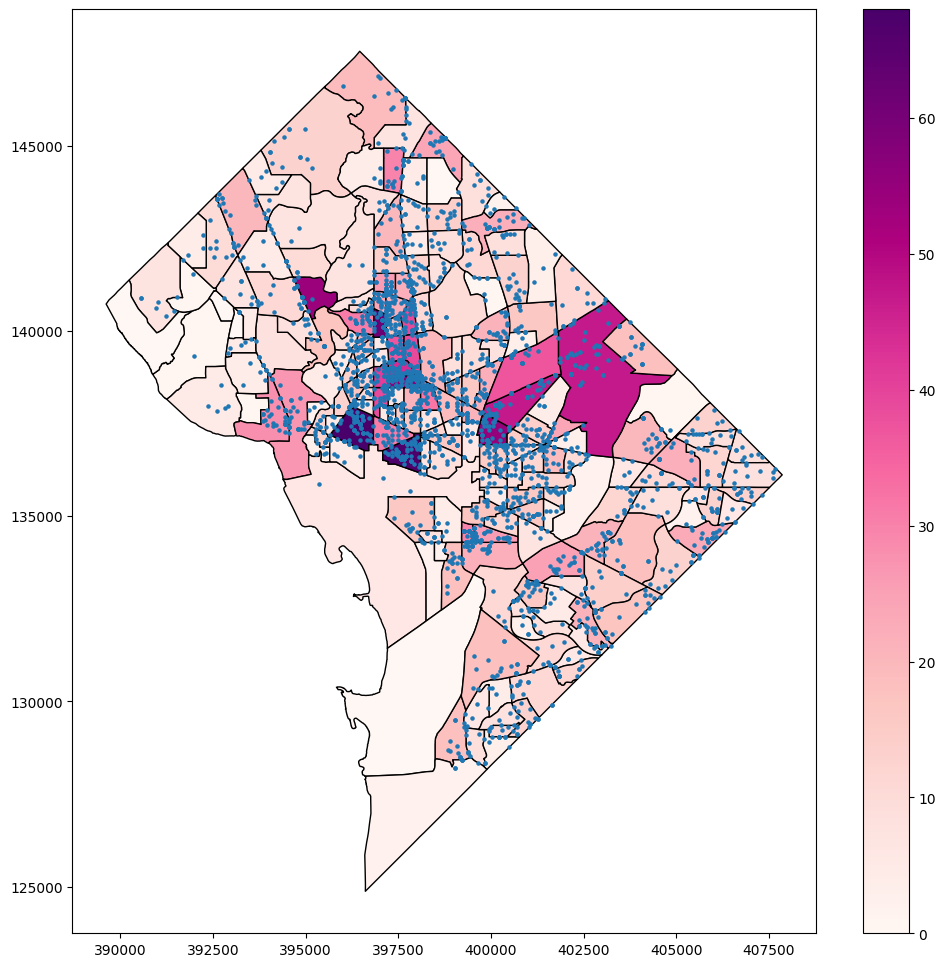

In [49]:
fig, ax = plt.subplots(figsize=(12,12))

# Plot the census tracts with color based on 'eatery_count'
dc_ct_crime.plot(ax=ax, column='crime_count', legend=True, cmap='RdPu', linewidth=1, edgecolor='black')

# Plot the crime incidents
dc_crime_rprj.plot(ax=ax, marker='o', markersize=5, legend=True)

# Show the plot
plt.show()

## Spatial Autocorrelation -- Crime Incidents across CENSUS BLOCKS in D.C.

In [50]:
# Read census block data
dc_census_block = gpd.read_file("https://www2.census.gov/geo/tiger/TIGER2020/BG/tl_2020_11_bg.zip")

In [51]:
dc_census_block_rprj = dc_census_block.to_crs("EPSG:6487")

In [52]:
# Reproject the `dc_crime` to match the CRS of the `dc_census_tract_rprj` GeoDataFrame
dc_crime_rprj = dc_crime.to_crs(dc_census_block_rprj.crs)

# Perform a spatial join between the reprojected eatery points and the census tracts.
# This assigns each eatery to a census tract if it is within the tract's boundaries.
dc_cb_crime = gpd.sjoin(dc_crime_rprj, dc_census_block_rprj, predicate='within', how='inner').reset_index(drop = True)
dc_cb_crime = dc_cb_crime.assign(crime_count = np.ones(dc_cb_crime.shape[0]))
dc_cb_crime = dc_cb_crime.groupby('GEOID')['crime_count'].sum().reset_index()

# Merge the crime counts with the census tracts GeoDataFrame
dc_cb_crime = dc_census_block_rprj.merge(dc_cb_crime, on='GEOID', how='left')

# Replace NaN values with 0 for tracts without crime incidents
dc_cb_crime['crime_count'] = dc_cb_crime['crime_count'].fillna(0)


In [53]:
dc_cb_crime.head()

,STATEFP,COUNTYFP,TRACTCE,BLKGRPCE,GEOID,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,crime_count
0,11,001,010800,1,110010108001,Block Group 1,G5030,S,112810,0,+38.9005669,-077.0474728,"POLYGON ((395651.030 136943.350, 395651.295 13...",0.0
1,11,001,010900,2,110010109002,Block Group 2,G5030,S,2270174,2933566,+38.8132364,-077.0238475,"POLYGON ((396595.679 125860.383, 396600.993 12...",2.0
2,11,001,007401,1,110010074011,Block Group 1,G5030,S,1029053,200980,+38.8668098,-076.9949201,"POLYGON ((399531.639 133441.098, 399703.649 13...",9.0
3,11,001,007403,1,110010074031,Block Group 1,G5030,S,126738,0,+38.8481009,-076.9774095,"POLYGON ((401625.668 130979.555, 401651.014 13...",4.0
4,11,001,007404,1,110010074041,Block Group 1,G5030,S,360630,0,+38.8514546,-076.9784997,"POLYGON ((401446.271 131728.707, 401496.003 13...",1.0


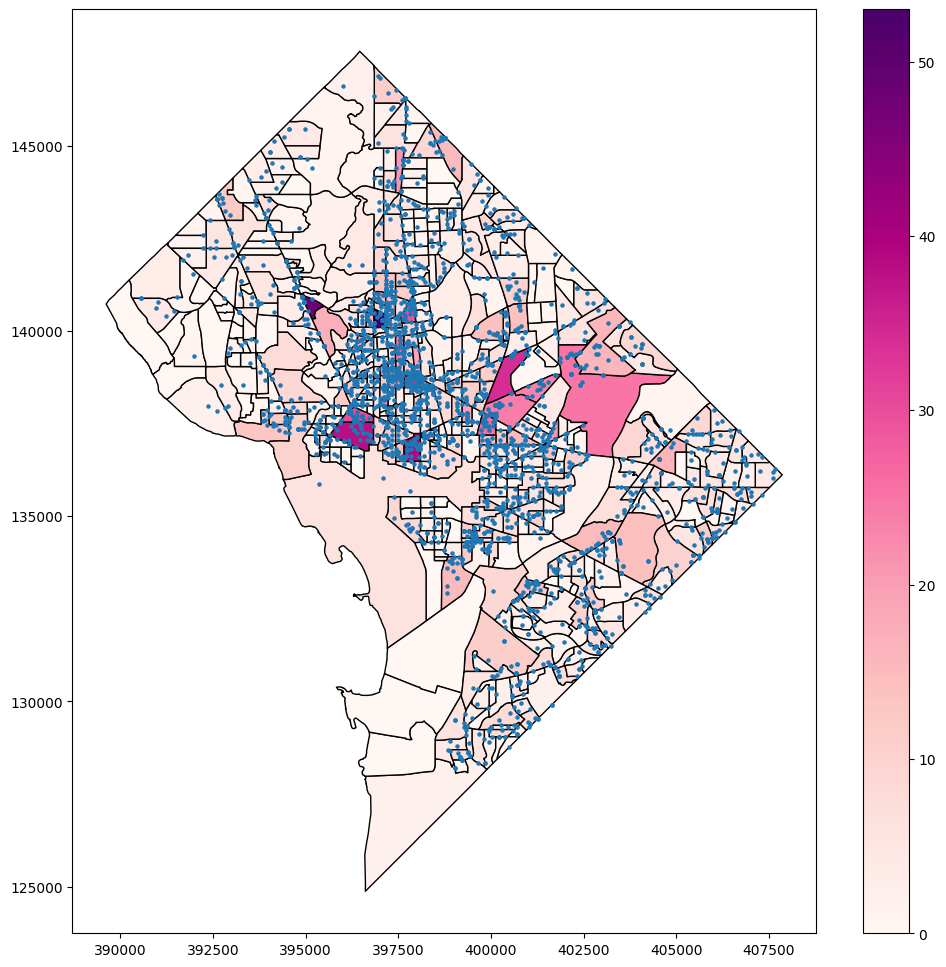

In [54]:
fig, ax = plt.subplots(figsize=(12,12))

# Plot the census tracts with color based on 'eatery_count'
dc_cb_crime.plot(ax=ax, column='crime_count', legend=True, cmap='RdPu', linewidth=1, edgecolor='black')

# Plot the crime incidents
dc_crime_rprj.plot(ax=ax, marker='o', markersize=5, legend=True)

# Show the plot
plt.show()

Spatial Autocorrelation -- Eateries across census tracts in DC

In [55]:
# Create spatial weights matrix
w = libpysal.weights.Queen.from_dataframe(dc_cb_crime)


In [56]:
# Moran's I
moran = esda.moran.Moran(dc_cb_crime["crime_count"], w)


In [57]:
print("Moran's I:", moran.I)


Moran's I: 0.16847580786977695


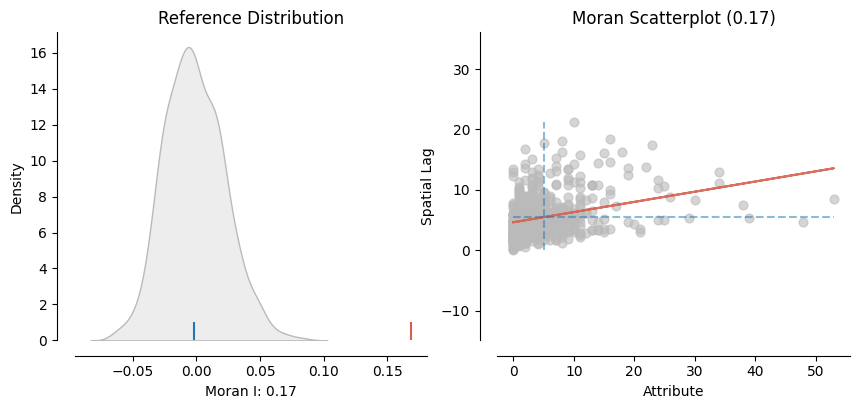

In [58]:
# Moran's scatterplot
esdaplot.plot_moran(moran, dc_cb_crime);


In [59]:
# Local Moran's I
local_moran = esda.moran.Moran_Local(dc_cb_crime["crime_count"], w)


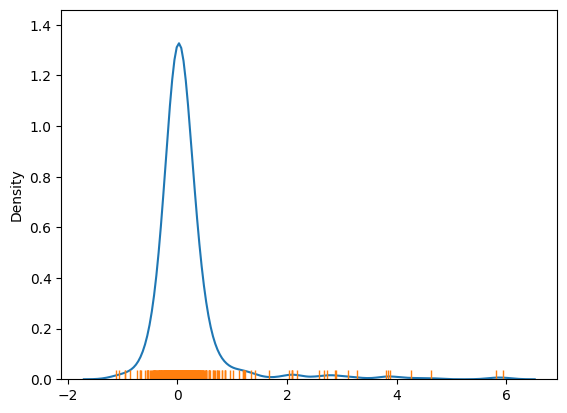

In [60]:
# plotting Local Moran's I
ax = sns.kdeplot(local_moran.Is)
sns.rugplot(local_moran.Is, ax=ax);

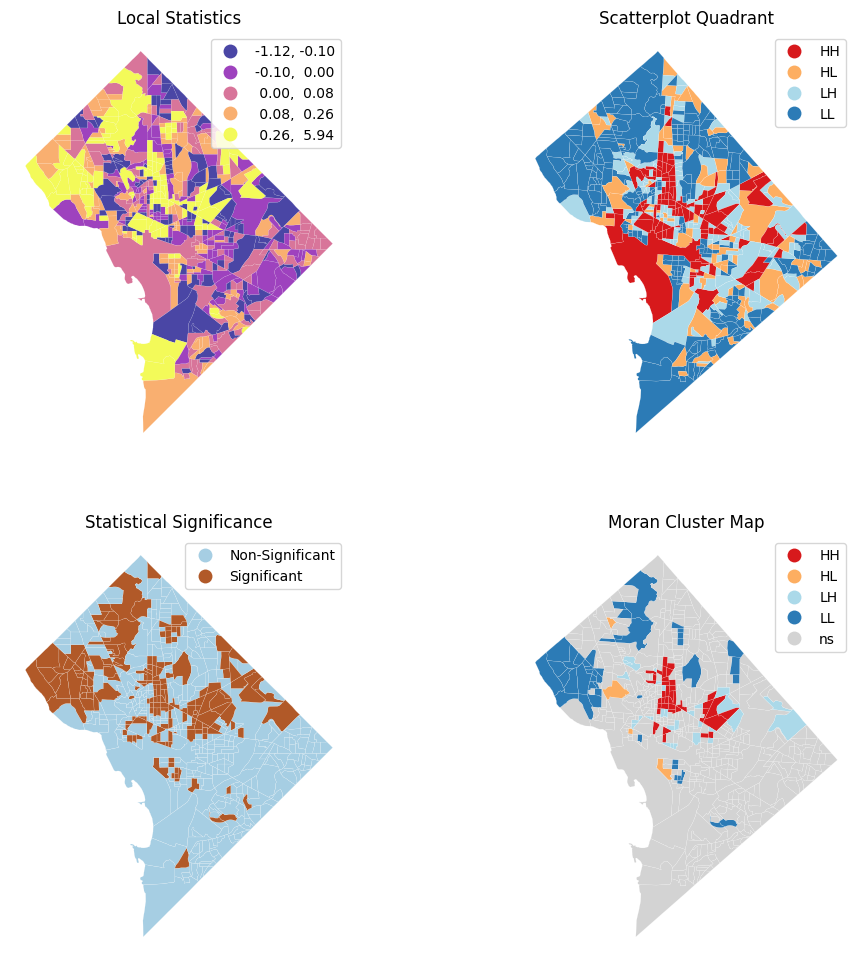

In [61]:
f, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))
axs = axs.flatten()

# Subplot 1: Choropleth of local statistics
ax = axs[0]
dc_cb_crime.assign(Is=local_moran.Is).plot(column="Is", cmap="plasma", scheme="quantiles", k=5, edgecolor="white", linewidth=0.1, alpha=0.75, legend=True, ax=ax)

# Subplot 2: Quadrant categories
ax = axs[1]
esdaplot.lisa_cluster(local_moran, dc_cb_crime.to_crs(26986), p=1, ax=ax)

# Subplot 3: Significance map (alpha=0.10)
ax = axs[2]
labels = pd.Series(1 * (local_moran.p_sim < 0.10), index=dc_cb_crime.index).map({1: "Significant", 0: "Non-Significant"})
dc_cb_crime.assign(cl=labels).plot(column="cl", categorical=True, k=2, cmap="Paired", linewidth=0.1, edgecolor="white", legend=True, ax=ax)

# Subplot 4: Cluster map
ax = axs[3]
esdaplot.lisa_cluster(local_moran, dc_cb_crime.to_crs(26986), p=0.05, ax=ax)

# Figure styling #
for i, ax in enumerate(axs.flatten()):
    ax.set_axis_off()
    ax.set_title(["Local Statistics","Scatterplot Quadrant","Statistical Significance","Moran Cluster Map"][i]);

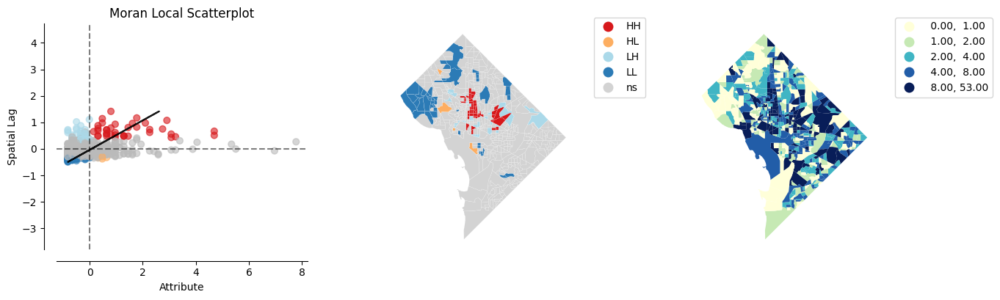

In [62]:
# plot the Moran plot (showing significant clusters and outliers) next to the resulting Moran Cluster Map.
esdaplot.plot_local_autocorrelation(local_moran, dc_cb_crime, 'crime_count', p=0.05);


In [63]:
# detecting clusters and outliers
dc_cb_crime[['GEOID', 'crime_count', 'geometry']].head()


,GEOID,crime_count,geometry
0,110010108001,0.0,"POLYGON ((395651.030 136943.350, 395651.295 13..."
1,110010109002,2.0,"POLYGON ((396595.679 125860.383, 396600.993 12..."
2,110010074011,9.0,"POLYGON ((399531.639 133441.098, 399703.649 13..."
3,110010074031,4.0,"POLYGON ((401625.668 130979.555, 401651.014 13..."
4,110010074041,1.0,"POLYGON ((401446.271 131728.707, 401496.003 13..."


In [64]:
# Calculate the local Moran's I statistics and assign them along with their associated p-values and quadrants to each zone
local_moran = esda.moran.Moran_Local(dc_cb_crime['crime_count'], w)
dc_cb_crime['local_moran_i'] = local_moran.Is
dc_cb_crime['local_moran_p_value'] = local_moran.p_sim
dc_cb_crime['local_moran_quadrant'] = local_moran.q

In [65]:
# Get the statistically significant clusters and outliers at alpha = 0.10
alpha = 0.10
hotspots = dc_cb_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 1")
coldspots = dc_cb_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 3")
doughnuts = dc_cb_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 2")
diamonds = dc_cb_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 4")
not_significant = dc_cb_crime.query(f"local_moran_p_value >= {alpha}")

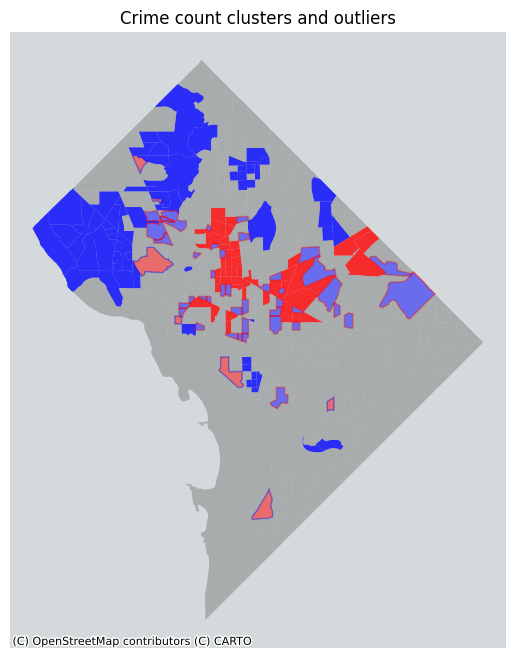

In [66]:
# Plot the hot spots, cold spots, diamonds and doughnuts.
fig, ax = plt.subplots(figsize=(16,8))
hotspots.plot(color='red',alpha=0.8, ax=ax, label='Hot Spot')
coldspots.plot(color='blue', alpha=0.8, ax=ax, label='Cold Spot')
diamonds.plot(color='red', edgecolor='blue', alpha=0.5, ax=ax, label='Diamonds')
doughnuts.plot(color='blue', edgecolor='red', alpha=0.5, ax=ax, label='Doughnuts')
not_significant.plot(color='gray', alpha=0.5, label='Not Significant', ax=ax)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=26986)
ax.set_title('Crime count clusters and outliers')
ax.axis('off');

## Exercise: Spatial Autocorrelation -- Crime Incidents across CENSUS TRACTS in D.C.

In [67]:
# Create spatial weights matrix
w = libpysal.weights.Queen.from_dataframe(dc_ct_crime)


In [68]:
# Moran's I
moran = esda.moran.Moran(dc_ct_crime["crime_count"], w)


In [69]:
print("Moran's I:", moran.I)


Moran's I: 0.1637667176711549


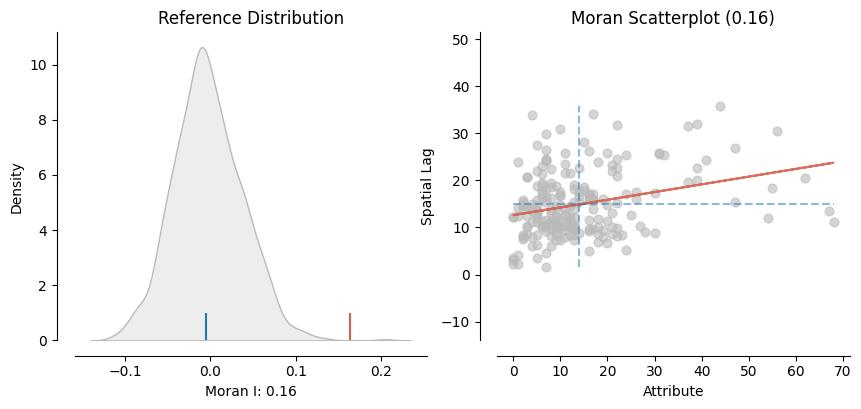

In [70]:
# Moran's scatterplot
esdaplot.plot_moran(moran, dc_ct_crime);


In [71]:
# Local Moran's I
local_moran = esda.moran.Moran_Local(dc_ct_crime["crime_count"], w)


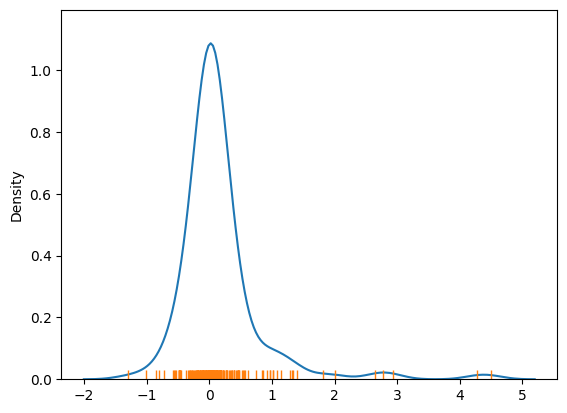

In [72]:
# plotting Local Moran's I
ax = sns.kdeplot(local_moran.Is)
sns.rugplot(local_moran.Is, ax=ax);

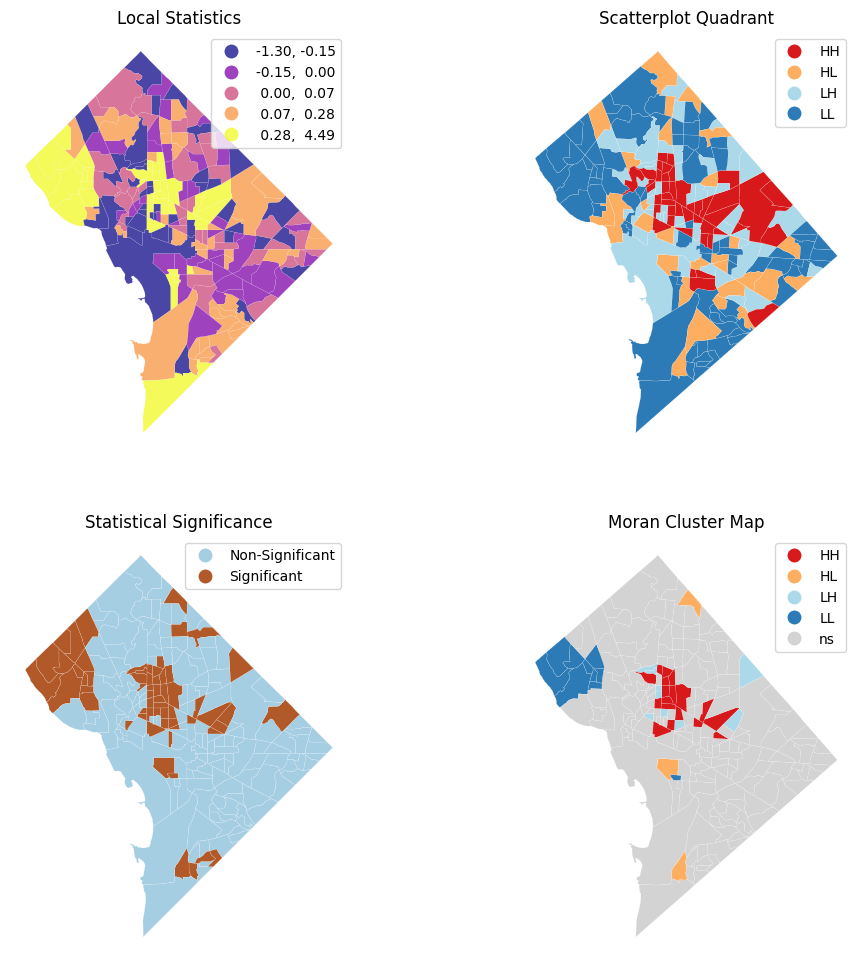

In [73]:
f, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))
axs = axs.flatten()

# Subplot 1: Choropleth of local statistics
ax = axs[0]
dc_ct_crime.assign(Is=local_moran.Is).plot(column="Is", cmap="plasma", scheme="quantiles", k=5, edgecolor="white", linewidth=0.1, alpha=0.75, legend=True, ax=ax)

# Subplot 2: Quadrant categories
ax = axs[1]
esdaplot.lisa_cluster(local_moran, dc_ct_crime.to_crs(26986), p=1, ax=ax)

# Subplot 3: Significance map (alpha=0.10)
ax = axs[2]
labels = pd.Series(1 * (local_moran.p_sim < 0.10), index=dc_ct_crime.index).map({1: "Significant", 0: "Non-Significant"})
dc_ct_crime.assign(cl=labels).plot(column="cl", categorical=True, k=2, cmap="Paired", linewidth=0.1, edgecolor="white", legend=True, ax=ax)

# Subplot 4: Cluster map
ax = axs[3]
esdaplot.lisa_cluster(local_moran, dc_ct_crime.to_crs(26986), p=0.05, ax=ax)

# Figure styling #
for i, ax in enumerate(axs.flatten()):
    ax.set_axis_off()
    ax.set_title(["Local Statistics","Scatterplot Quadrant","Statistical Significance","Moran Cluster Map"][i]);

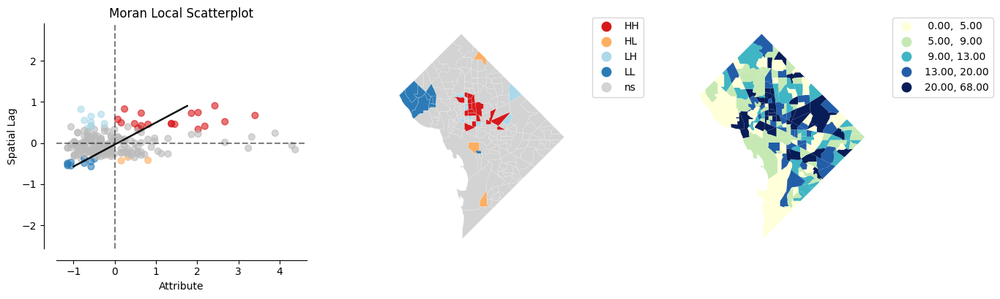

In [74]:
# plot the Moran plot (showing significant clusters and outliers) next to the resulting Moran Cluster Map.
esdaplot.plot_local_autocorrelation(local_moran, dc_ct_crime, 'crime_count', p=0.05);


In [75]:
# detecting clusters and outliers
dc_ct_crime[['GEOID', 'crime_count', 'geometry']].head()


,GEOID,crime_count,geometry
0,11001004001,5.0,"POLYGON ((395648.402 139264.423, 395659.339 13..."
1,11001004002,13.0,"POLYGON ((395984.938 138716.974, 395984.768 13..."
2,11001003600,37.0,"POLYGON ((397189.939 139855.623, 397210.581 13..."
3,11001004201,13.0,"POLYGON ((396386.882 138479.777, 396387.002 13..."
4,11001004202,17.0,"POLYGON ((396011.287 138515.924, 396033.150 13..."


In [76]:
# Calculate the local Moran's I statistics and assign them along with their associated p-values and quadrants to each zone
local_moran = esda.moran.Moran_Local(dc_ct_crime['crime_count'], w)
dc_ct_crime['local_moran_i'] = local_moran.Is
dc_ct_crime['local_moran_p_value'] = local_moran.p_sim
dc_ct_crime['local_moran_quadrant'] = local_moran.q

In [77]:
# Get the statistically significant clusters and outliers at alpha = 0.10
alpha = 0.10
hotspots = dc_ct_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 1")
coldspots = dc_ct_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 3")
doughnuts = dc_ct_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 2")
diamonds = dc_ct_crime.query(f"local_moran_p_value < {alpha} & local_moran_quadrant == 4")
not_significant = dc_ct_crime.query(f"local_moran_p_value >= {alpha}")

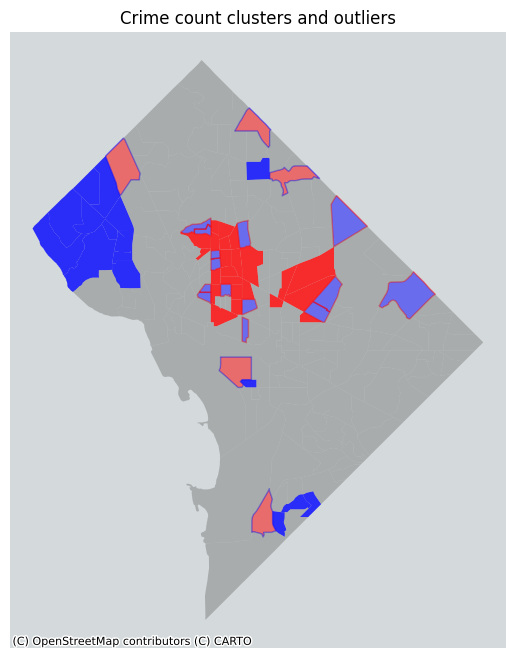

In [78]:
# Plot the hot spots, cold spots, diamonds and doughnuts.
fig, ax = plt.subplots(figsize=(16,8))
hotspots.plot(color='red',alpha=0.8, ax=ax, label='Hot Spot')
coldspots.plot(color='blue', alpha=0.8, ax=ax, label='Cold Spot')
diamonds.plot(color='red', edgecolor='blue', alpha=0.5, ax=ax, label='Diamonds')
doughnuts.plot(color='blue', edgecolor='red', alpha=0.5, ax=ax, label='Doughnuts')
not_significant.plot(color='gray', alpha=0.5, label='Not Significant', ax=ax)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=26986)
ax.set_title('Crime count clusters and outliers')
ax.axis('off');

# 3. Walksheds of Metro Staions in D.C.

## Retrieve Metro Stations Data
* Data Source: https://opendata.dc.gov/datasets/DCGIS::metro-stations-in-dc/about
* Walkshed radius: https://www.mwcog.org/newsroom/2019/07/16/walksheds-show-planners-how-easily-people-can-walk-to-transit/

In [79]:
dc_station_url = "https://opendata.dc.gov/datasets/DCGIS::metro-stations-in-dc.geojson"

# Read the data into a GeoDataFrame
dc_station_gdf = gpd.read_file(dc_station_url)

# Reproject
dc_station_gdf_rprj = dc_station_gdf.to_crs(dc_census_tract_rprj.crs)

# Remove the stations outside the boundary of D.C.
dc_station_gdf_rprj = gpd.clip(dc_station_gdf_rprj, dc_census_tract_rprj)

# Errors will show after running. It would no affect the results.

<Axes: >

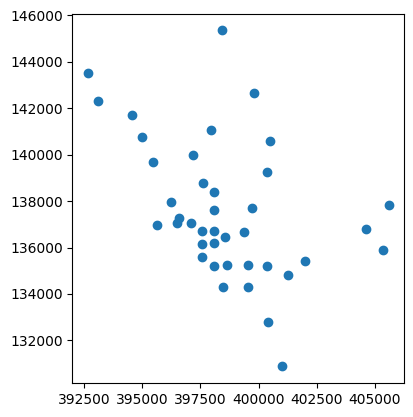

In [80]:
dc_station_gdf_rprj.plot()

## Create Walksheds Using Simple Buffer

In [81]:
# Set Buffer Raidus
buffer_distance = 804.67 # Half a mile is 804.67 metres.

# Create the buffer around each point to get a GeoSeries of buffered geometries
walksheds_simple_buffer = dc_station_gdf_rprj.geometry.buffer(buffer_distance)

# Create a new GeoDataFrame from the buffered geometries
walkshed_sb_gdf = gpd.GeoDataFrame(geometry=walksheds_simple_buffer)

# If you want to retain the original data from 'dc_station_gdf_rprj', you can join it with the new GeoDataFrame
walkshed_sb_gdf = walkshed_sb_gdf.join(dc_station_gdf_rprj.drop(columns='geometry'))

<Axes: >

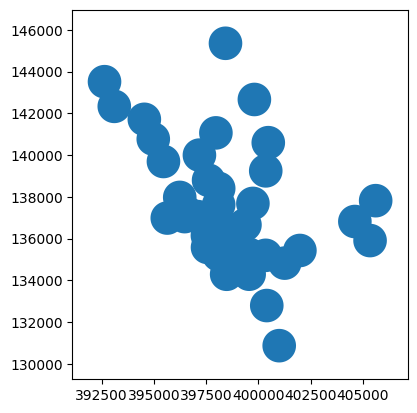

In [82]:
walkshed_sb_gdf.plot()

### Q1: How many eateries in each walkshed?

In [83]:
dc_walkshed_sb_eatery = gpd.sjoin(dc_eatery_gdf_rprj, walkshed_sb_gdf, predicate='within', how='inner').reset_index(drop = True)
dc_walkshed_sb_eatery = dc_walkshed_sb_eatery.assign(eatery_count = np.ones(dc_walkshed_sb_eatery.shape[0]))
dc_walkshed_sb_eatery = dc_walkshed_sb_eatery.groupby('GIS_ID')['eatery_count'].sum().reset_index()

# Merge the eatery counts with the walkshed GeoDataFrame
dc_walkshed_sb_eatery = walkshed_sb_gdf.merge(dc_walkshed_sb_eatery, on='GIS_ID', how='left')

# Replace NaN values with 0 for walkshed without eatery
dc_walkshed_sb_eatery['eatery_count'] = dc_walkshed_sb_eatery['eatery_count'].fillna(0)

#### Visualization

In [84]:
dc_ct_eatery_geog = dc_ct_eatery.to_crs(dc_census_tract.crs)
dc_eatery_geog = dc_eatery.to_crs(dc_census_tract.crs)
dc_walkshed_sb_eatery_geog = dc_walkshed_sb_eatery.to_crs(dc_census_tract.crs)

# Create a colormap and normalizer for the unique types of eateries
unique_types = dc_eatery_geog.Type.unique()
cmap = matplotlib.cm.get_cmap('tab10', len(unique_types))  # 'tab10' is a good discrete colormap for categorical data
norm = matplotlib.colors.Normalize(vmin=0, vmax=len(unique_types) - 1)

# Initialize the map centered around Washington D.C.
m = folium.Map(location=[38.9072, -77.0369], zoom_start=12, tiles='CartoDB Positron')

# Add the census tracts to the map with color based on 'eatery_density'
folium.Choropleth(
    geo_data=dc_ct_eatery_geog.to_json(),
    name='Census Tracts',
    data=dc_ct_eatery_geog,
    columns=['GEOID', 'eatery_density'],
    key_on='feature.properties.GEOID',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Eatery Density by Census Tracts'
).add_to(m)

# Add the walksheds to the map
folium.Choropleth(
    geo_data=dc_walkshed_sb_eatery_geog.to_json(),
    name='Walkshed with Simple Buffer',
    data=dc_walkshed_sb_eatery_geog,
    columns=['GIS_ID', 'eatery_count'],
    key_on='feature.properties.GIS_ID',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Eatery Counts by Walksheds'
).add_to(m)

# Create a feature group for each unique type of eatery
feature_groups = {}
for eatery_type in unique_types:
    feature_group = folium.FeatureGroup(name=str(eatery_type))
    feature_groups[eatery_type] = feature_group
    feature_group.add_to(m)

# Add the eateries to their respective feature group
for _, row in dc_eatery_geog.iterrows():
    eatery_type = row['Type']
    color = matplotlib.colors.to_hex(cmap(norm(unique_types.tolist().index(eatery_type))))
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        color=color,
        radius=1.5,
        fill=True,
        fill_color=color,
        fill_opacity=0.7
    ).add_to(feature_groups[eatery_type])

# Add the layer control to toggle feature groups
folium.LayerControl().add_to(m)

# Display the map
m  # If you're using a Jupyter notebook, this will display the map inline.


### Q2: Which eatery is located within the highest number of station walksheds?

In [85]:
# Perform the spatial join
joined_gdf = gpd.sjoin(dc_eatery_gdf_rprj, walkshed_sb_gdf, predicate='within', how='left').reset_index(drop = True)

# Count the number of walksheds each eatery is within
eatery_walkshed_counts = joined_gdf.groupby('UID').size()

# Find the eatery with the highest count
most_walksheds = eatery_walkshed_counts.idxmax()
highest_count = eatery_walkshed_counts.max()

# Get the details of the eatery with the most walksheds
eatery_with_most_walksheds = dc_eatery_gdf_rprj.loc[dc_eatery_gdf_rprj['UID'] == most_walksheds]

print(f"The eatery with the most walksheds is: {(eatery_with_most_walksheds.Name.values)}")
print(f"Number of walksheds: {highest_count}")


The eatery with the most walksheds is: ['Oya Restaurant & Lounge']
Number of walksheds: 6


## Create Walksheds With Road Network

* The cell below would take no more than 7 mins to finish.

In [86]:
# Define the walking distance in meters
walking_distance_metres = 804.67 # Half a mile is 804.67 metres.
alpha = 300

# Initialize an empty list to hold the walkshed polygons
walkshed_as = []

# Loop through each station to calculate walksheds
# It would take no more than 5 mins
for index, station in dc_station_gdf.iterrows():
    # Get the x and y coordinates of the station
    x, y = station.geometry.x, station.geometry.y

    # Create the network graph around the station
    G = ox.graph_from_point((y, x), dist=walking_distance_metres, dist_type='network', network_type='walk')

    # Find the node in the graph that's closest to the station
    G_proj = ox.project_graph(G)
    center_node = ox.distance.nearest_nodes(G_proj, x, y)

    # Create a subgraph within the walking distance
    subgraph = nx.ego_graph(G_proj, center_node, radius=walking_distance_metres, distance='length')

    # Use the nodes from the subgraph to create an alphashape polygon
    node_points = [(data["lon"], data["lat"]) for node, data in subgraph.nodes(data=True)]
    if len(node_points) > 3:  # alphashape requires at least 4 points to compute a shape
        alpha_shape = alphashape(node_points, alpha=alpha)
        walkshed_as.append(gpd.GeoDataFrame([[station['GIS_ID'], alpha_shape]], columns=['GIS_ID', 'geometry']))

# Combine all walkshed polygons into a single GeoDataFrame
walkshed_as_gdf = gpd.GeoDataFrame(pd.concat(walkshed_as, ignore_index=True)).set_crs("EPSG:4326")

<Axes: >

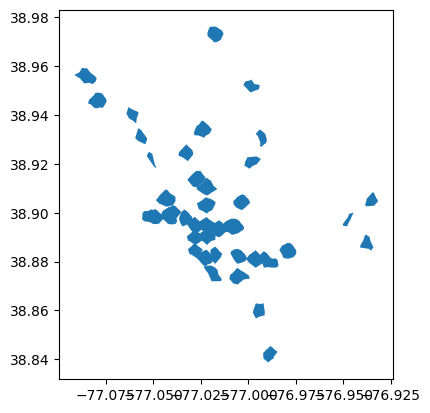

In [87]:
walkshed_as_gdf.plot()

### Exercie 1: How many eateries in each walkshed?

In [88]:
walkshed_as_gdf_rprj = walkshed_as_gdf.to_crs(dc_census_tract_rprj.crs)
dc_walkshed_as_eatery = gpd.sjoin(dc_eatery_gdf_rprj, walkshed_as_gdf_rprj, predicate='within', how='inner').reset_index(drop = True)
dc_walkshed_as_eatery = dc_walkshed_as_eatery.assign(eatery_count = np.ones(dc_walkshed_as_eatery.shape[0]))
dc_walkshed_as_eatery = dc_walkshed_as_eatery.groupby('GIS_ID')['eatery_count'].sum().reset_index()

# Merge the eatery counts with the walkshed GeoDataFrame
dc_walkshed_as_eatery = walkshed_as_gdf.merge(dc_walkshed_as_eatery, on='GIS_ID', how='left')

# Replace NaN values with 0 for walkshed without eatery
dc_walkshed_as_eatery['station_count'] = dc_walkshed_as_eatery['eatery_count'].fillna(0)

#### Visualization

In [89]:
dc_ct_eatery_geog = dc_ct_eatery.to_crs(dc_census_tract.crs)
dc_eatery_geog = dc_eatery.to_crs(dc_census_tract.crs)
dc_walkshed_as_eatery_geog = dc_walkshed_as_eatery.to_crs(dc_census_tract.crs)
# Create a colormap and normalizer for the unique types of eateries
unique_types = dc_eatery_geog.Type.unique()
cmap = matplotlib.cm.get_cmap('tab10', len(unique_types))  # 'tab10' is a good discrete colormap for categorical data
norm = matplotlib.colors.Normalize(vmin=0, vmax=len(unique_types) - 1)

# Initialize the map centered around Washington D.C.
m = folium.Map(location=[38.9072, -77.0369], zoom_start=12, tiles='CartoDB Positron')

# Add the census tracts to the map with color based on 'eatery_density'
folium.Choropleth(
    geo_data=dc_ct_eatery_geog.to_json(),
    name='Census Tracts',
    data=dc_ct_eatery_geog,
    columns=['GEOID', 'eatery_density'],
    key_on='feature.properties.GEOID',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Eatery Density by Census Tracts'
).add_to(m)

# Add the walksheds to the map
folium.Choropleth(
    geo_data=dc_walkshed_as_eatery_geog.to_json(),
    name='Walkshed with alphashape',
    data=dc_walkshed_as_eatery_geog,
    columns=['GIS_ID', 'eatery_count'],
    key_on='feature.properties.GIS_ID',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Eatery Counts by Walksheds'
).add_to(m)

# Create a feature group for each unique type of eatery
feature_groups = {}
for eatery_type in unique_types:
    feature_group = folium.FeatureGroup(name=str(eatery_type))
    feature_groups[eatery_type] = feature_group
    feature_group.add_to(m)

# Add the eateries to their respective feature group
for _, row in dc_eatery_geog.iterrows():
    eatery_type = row['Type']
    color = matplotlib.colors.to_hex(cmap(norm(unique_types.tolist().index(eatery_type))))
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        color=color,
        radius=1.5,
        fill=True,
        fill_color=color,
        fill_opacity=0.7
    ).add_to(feature_groups[eatery_type])

# Add the layer control to toggle feature groups
folium.LayerControl().add_to(m)

# Display the map
m  # If you're using a Jupyter notebook, this will display the map inline.


### Exercise 2: Which eatery is located within the highest number of station walkshed?

In [90]:
# Perform the spatial join
joined_gdf = gpd.sjoin(dc_eatery_gdf_rprj, walkshed_as_gdf_rprj, predicate='within', how='left').reset_index(drop = True)

# Count the number of walksheds each eatery is within
eatery_walkshed_counts = joined_gdf.groupby('UID').size()  # Replace 'eatery_id' with the appropriate identifier for eateries

# Find the eatery with the highest count
most_walksheds = eatery_walkshed_counts.idxmax()
highest_count = eatery_walkshed_counts.max()

# Get the details of the eatery with the most walksheds
eatery_with_most_walksheds = dc_eatery_gdf_rprj.loc[dc_eatery_gdf_rprj['UID'] == most_walksheds]

print(f"The eatery with the most walksheds is: {(eatery_with_most_walksheds.Name.values)}")
print(f"Number of walksheds: {highest_count}")


The eatery with the most walksheds is: ['Avenue Grill']
Number of walksheds: 2


# NDVI of Walksheds

## Reading Rasters with Rasterio

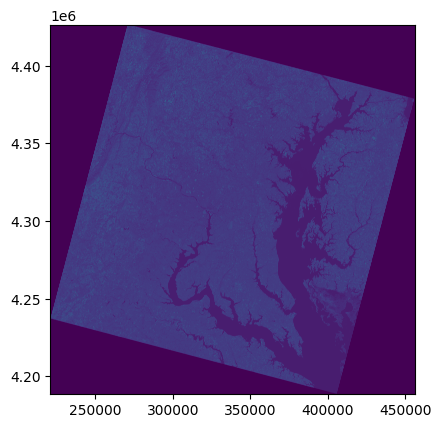

<Axes: >

In [91]:
# plot one band (Near Infrared)
# link to get the raster data:
# nirband = "https://www.dropbox.com/scl/fi/jhlov245pautfmkggieop/LC09_L1TP_015033_20231103_20231103_02_T1_B5.TIF?rlkey=5ympdgn2bxnngsy4ke212xm7x&dl=1"
# you should download and store it in your working directory

nirband = './LC09_L1TP_015033_20231103_20231103_02_T1_B5.tiff'

# open the raster with rasterio and plot
nirband_raster = rasterio.open(nirband)
show((nirband_raster, 1))

## Plot True Color Raster

In [92]:
# read in multiple bands
# It would take no more than 2 mins.

# You can also get the data from these links.
# you should download and store them in your working directory
# redband = "https://www.dropbox.com/scl/fi/riufhhwfd6ioqboe2ai4i/LC09_L1TP_015033_20231103_20231103_02_T1_B4.TIF?rlkey=ha19z35sk964jzqrvmfvfzl5u&dl=1"
# grnband = "https://www.dropbox.com/scl/fi/a7vt3vi7hqzlaqy0v9f8b/LC09_L1TP_015033_20231103_20231103_02_T1_B3.TIF?rlkey=rnihwnu3mjg055qy8o4h9tq5z&dl=1"
# bluband = "https://www.dropbox.com/scl/fi/noh7796lb0utx1b9lnime/LC09_L1TP_015033_20231103_20231103_02_T1_B2.TIF?rlkey=bze1j8quwq61vny9n6to48sx4&dl=1"


redband = './LC09_L1TP_015033_20231103_20231103_02_T1_B4.tiff'
grnband = './LC09_L1TP_015033_20231103_20231103_02_T1_B3.tiff'
bluband = './LC09_L1TP_015033_20231103_20231103_02_T1_B2.tiff'

with rasterio.open(nirband) as src:
  nir = src.read(1)

with rasterio.open(redband) as src:
  red = src.read(1)

with rasterio.open(grnband) as src:
  grn = src.read(1)

with rasterio.open(bluband) as src:
  blu = src.read(1)

In [93]:
# Function to normalize the grid values
def normalize(band):
    """Normalizes numpy arrays into scale 0.0 - 1.0"""
    band_min, band_max = band.min(), band.max()
    return ((band - band_min)/(band_max - band_min))


In [94]:
# Normalize the bands
redn = normalize(red)
grnn = normalize(grn)
blun = normalize(blu)
nirn = normalize(nir)

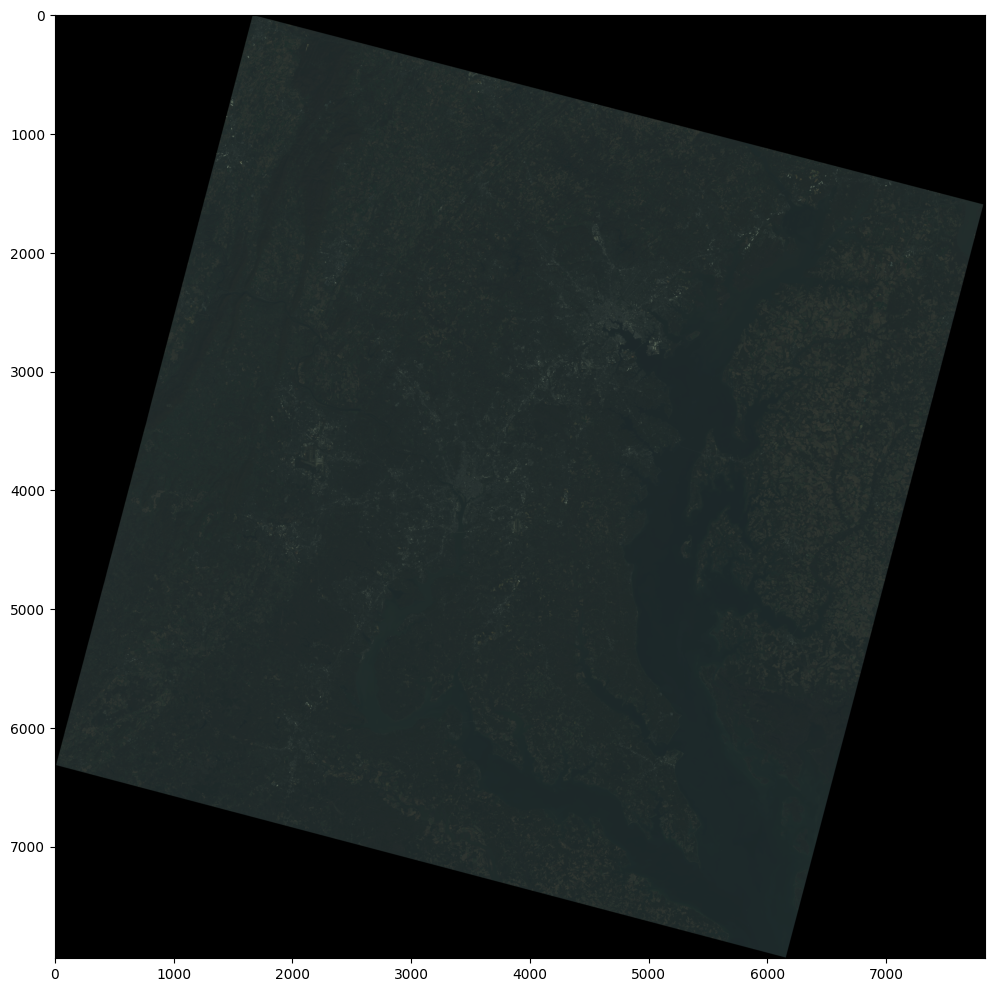

In [95]:
# Create RGB natural color composite
rgb = np.dstack((redn, grnn, blun))

# Plot the composite RGB image
plt.figure(figsize=(12,17))
plt.imshow(rgb, vmin=0, vmax=1)

## Plot NDVI

The Normalized Difference Vegetation Index (NDVI) is an idex that uses an image's Near-Infrared and Red bands to highlight the amount of "greenness" in an image

In [96]:
# create the NDVI function
def calc_ndvi(nir,red):
    '''Calculate NDVI from integer arrays'''
    nir = nir.astype(float)
    red = red.astype(float)
    ndvi = (nir - red) / (nir + red)
    return ndvi

In [97]:
# calculate the ndvi
ndvi = calc_ndvi(nirn,redn)

Text(0, 0.5, 'Row #')

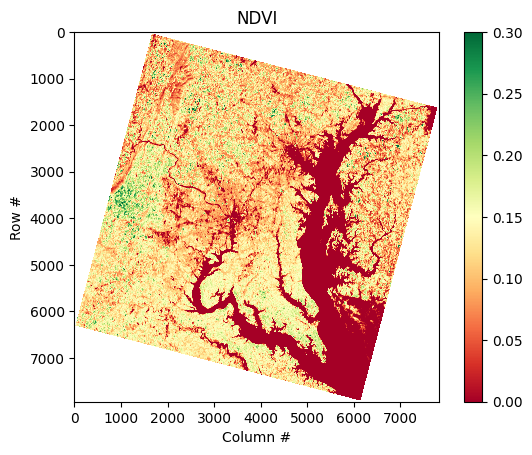

In [98]:
plt.imshow(ndvi, cmap='RdYlGn',vmin=0,vmax=.3)
plt.colorbar()
plt.title('NDVI')
plt.xlabel('Column #')
plt.ylabel('Row #')

## Zonal Statistics

We can get the average raster cell values for a set of vectors (polygons)

In [99]:
# define the top left corner (raster origin) and cell size
transform=rasterio.transform.from_origin(221085.0, 4426515.0, 30.0, 30.0 )

# define the coordinate system (UTM zone 18)
crs = rasterio.crs.CRS.from_epsg(32618)

# convert the NDVI matrix back into a raster (so that we can get the correct coordinate information)
with rasterio.open('MD_DC_VA.tif', 'w', driver='GTiff',
                   height=ndvi.shape[0], width=ndvi.shape[1],
                   count=1, dtype=ndvi.dtype,
                   crs= crs,
                   transform=transform ) as output:
    output.write(ndvi,1)
    output.close()

In [100]:
# read the ndvi raster back in
ndvi_raster =rasterio.open('MD_DC_VA.tif')

In [101]:
# project the walksheds (calculated by alphashape) to the same coordinate system as the raster
walksheds_ndvi = walkshed_as_gdf.to_crs(epsg=32618)

<Axes: >

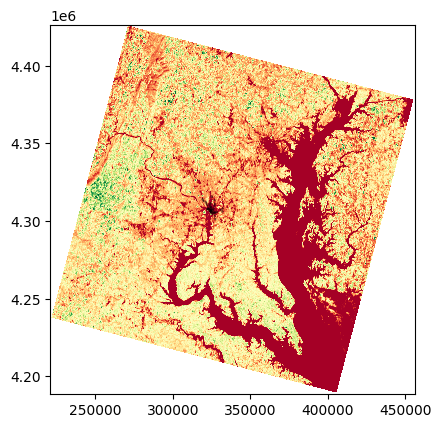

In [102]:
# plot both the ndvi raster and the walksheds
# Walkshed are in the center parts.
fig, ax = plt.subplots()
walksheds_ndvi.plot(ax=ax, facecolor='none', edgecolor='black', alpha=.5)
show(ndvi_raster, cmap='RdYlGn', ax=ax, vmin=0, vmax=.3)

In [103]:
# get the average ndvi per walkshed
avg_ndvi_per_walkshed = rstats.zonal_stats(walksheds_ndvi.geometry, 'MD_DC_VA.tif')
avg = [r['mean'] for r in avg_ndvi_per_walkshed]
walksheds_ndvi['ndvi'] = avg

In [104]:
# print the first few rows
walksheds_ndvi.head()

,GIS_ID,geometry,ndvi
0,MetroStnPt_1,"POLYGON ((325234.449 4316073.960, 325292.502 4...",0.025055
1,MetroStnPt_2,"POLYGON ((319737.169 4313714.755, 319618.820 4...",0.017795
2,MetroStnPt_3,"POLYGON ((326563.969 4313549.148, 326792.078 4...",0.007143
3,MetroStnPt_4,"POLYGON ((319365.039 4312715.063, 319416.870 4...",0.037335
4,MetroStnPt_5,"POLYGON ((321584.775 4312303.631, 321663.741 4...",0.060223


<Axes: >

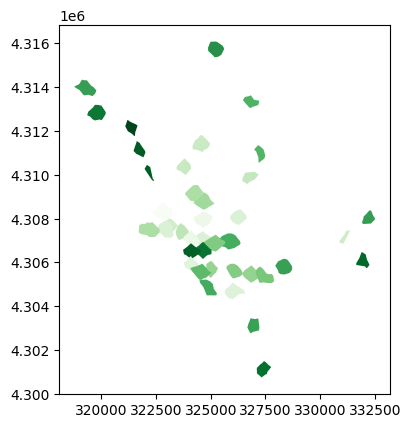

In [105]:
# choropleth map of walksheds and ndvi
walksheds_ndvi.plot('ndvi', cmap='Greens')

# A Practical Application of Folium


## Initialize Folium

- Given a pair of latitude and longitude, folium can create a map centered around that location.

- `zoom_start` initializes the zoom level for the map. We set it to `12` for our convenience

In [106]:
m = folium.Map(location=[38.9072, -77.0369], # Washington D.C
               zoom_start=12)

# display the map
m

## Add a Marker to the map

Using the `folium.Marker()` method.<br /> <br />It takes as parameter: <br />
    - location (where the marker is placed on the map [lat, long])<br />
    - popup (text content shown when the marker is clicked) <br />
    - icon (popup icon)
    

In [107]:
marker = folium.Marker(
    location=[38.9072, -77.0369], # Washington D.C
    popup='The White House',
    icon=folium.Icon(color='cadetblue', icon='glyphicon-flag'),
)
marker.add_to(m)
m

We could also use the variant `folium.CircleMarker()`

In [108]:
new_map = folium.Map(location=[38.9072, -77.0369], zoom_start=12, tiles='OpenStreetMap')

circle_marker = folium.CircleMarker(
    location=[38.9072, -77.0369],
    radius=12,  # Larger radius for a bigger circle
    color='blue',
    fill=True,
    fill_color='blue',
    fill_opacity=0.7,
    popup='The White House'
)
circle_marker.add_to(new_map)
new_map

- It is possible to create your custom icons with a specified image and size using icons from Font Awesome or Bootstap

In [109]:
# Assuming you're continuing from the previous map 'm'
import folium
new_map = folium.Map(location=[38.9072, -77.0369], zoom_start=12, tiles='OpenStreetMap')

# You would replace this with the URL of your image
icon_image_url = 'https://pic.onlinewebfonts.com/thumbnails/icons_547378.svg'  # Placeholder URL

# Create a custom icon by specifying the image URL and size
custom_icon = folium.CustomIcon(
    icon_image=icon_image_url,
    icon_size=(55, 55)  # Example size, you can adjust as needed
)

# Add a marker with the custom icon to the map
folium.Marker(
    location=[38.9072, -77.0369],
    popup='A marker with a custom icon',
    icon=custom_icon
).add_to(new_map)

# Display the map
new_map


## Add Tile Layers

- Tiles are the map's background. Different tile layers can be added for different map styles

- Some common tile styles are `'Stamen Terrain'`, `'Stamen Toner'`, `'Stamen Watercolor'`, `'CartoDB positron'`, `'CartoDB dark_matter'`


In [110]:
new_map = folium.Map(location=[38.9072, -77.0369], zoom_start=13, tiles='OpenStreetMap')

folium.TileLayer(
    tiles='CartoDB Positron',
    attr='Map tiles by Carto, under CC BY 3.0. Data by OpenStreetMap, under ODbL'
).add_to(new_map)

# Add layer control to toggle tile layers
folium.LayerControl().add_to(new_map)
new_map

## Add a Chloropleth map

- Folium uses the the `folium.Chorpoleth()` method to create choropleth maps which are thematic maps where areas are shaded based on a statistical
variable

In [111]:
# Create a map instance centered on the United States
m = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

# Get GeoJSON data for US states (this URL is just an example; you can use your own GeoJSON file)
geojson_url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data/us-states.json'
geojson_data = requests.get(geojson_url).json()

# Generate some example data (this would be your actual data)
state_data = pd.DataFrame({
    'state': [state['id'] for state in geojson_data['features']],
    'value': np.random.rand(len(geojson_data['features']))
})

print(state_data.head())

# Add the choropleth layer to the map
folium.Choropleth(
    geo_data=geojson_data,
    name='choropleth',
    data=state_data,
    columns=['state', 'value'],
    key_on='feature.id',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Random Data'
).add_to(m)

# Add a layer control panel to the map
folium.LayerControl().add_to(m)

# Display the map
m


  state     value
0    AL  0.462292
1    AK  0.714283
2    AZ  0.185305
3    AR  0.699550
4    CA  0.685382


<i> Nugget <i/>  <br />

Every expert spatial data scientist takes their time to read the documentations of packages they frequently use. Its the best way to explore and familiarize yourself with the package.

[Here's the link](https://python-visualization.github.io/folium/latest/#) to Folium's documentation.

## Revisit Eatery Data


In [112]:
dc_eatery_geog.head()

,UID,Name,Type,Latitude,Longitude,geometry,index_right,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON
0,60471261,Cafe Saint Ex,bar,38.915421,-77.031701,POINT (-77.03170 38.91542),39,11,001,004402,11001004402,44.02,Census Tract 44.02,G5020,S,274746,0,+38.9155152,-077.0270354
1,745905564,Ambassador Restaurant,restaurant,38.915983,-77.023734,POINT (-77.02373 38.91598),39,11,001,004402,11001004402,44.02,Census Tract 44.02,G5020,S,274746,0,+38.9155152,-077.0270354
2,750467821,Bar Pilar,restaurant,38.915126,-77.031705,POINT (-77.03170 38.91513),39,11,001,004402,11001004402,44.02,Census Tract 44.02,G5020,S,274746,0,+38.9155152,-077.0270354
3,750467824,Axum Restaurant,restaurant,38.916574,-77.024271,POINT (-77.02427 38.91657),39,11,001,004402,11001004402,44.02,Census Tract 44.02,G5020,S,274746,0,+38.9155152,-077.0270354
4,750467826,Hawthorne,bar,38.916811,-77.031047,POINT (-77.03105 38.91681),39,11,001,004402,11001004402,44.02,Census Tract 44.02,G5020,S,274746,0,+38.9155152,-077.0270354


Task: Pop-up window
- Define a function to create popup messages for markers. A cool feature of folium is that you can create a marker denoting each point and customize the marker as popup

- You can include as many field as you want, but here we'll use the `Name`, `Type`, `Latitude`, `Longitude` and `NAME`.

In [113]:
def make_popup(row):
    return folium.Popup(f"""
    <b>Eatery Name:</b> {row['Name']}<br>
    <b>Eatery Type:</b> {row['Type']}<br>
    <b>Coordinates:</b> {row['Latitude'], row['Longitude']}<br>
    <b>Census Tract Code: </b> {row['NAME']}<br>
    """, max_width=250)

- Define a color mapping for permit types using folium's color mapping options

- <b> Note: <b/>
we can only use the colors available within Folium. Here's a [link to the list of colors](https://python-visualization.github.io/folium/latest/reference.html#:~:text=%5B%E2%80%98red%E2%80%99%2C%20%E2%80%98blue%E2%80%99%2C%20%E2%80%98green,gray%E2%80%99%2C%20%E2%80%98black%E2%80%99%2C%20%E2%80%98lightgray%E2%80%99%5D) available within folium

In [114]:
color_mapping = {
    'bar': 'blue',
    'restaurant': 'green',
    'cafe': 'purple',
    'biergarten': 'orange',
    'pub': 'darkblue'
}

# Default color if permit type is not in the mapping
default_color = 'lightgray'

- Create a new map instance

- Add markers to the map, colored by eatery type

In [115]:
m_colored_markers = folium.Map(location=[38.9072, -77.0369], zoom_start=12)

for _, row in dc_eatery_geog.iterrows():
    # Get the color for the eatery type, use default color if not found
    marker_color = color_mapping.get(row['Type'], default_color)

    # Add marker to the map
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=make_popup(row),
        icon=folium.Icon(color=marker_color)
    ).add_to(m_colored_markers)

# Save the map to an HTML file
map_colored_markers_path = 'eatery_map_colored_markers.html'
m_colored_markers.save(map_colored_markers_path)

# Output the path to the saved HTML file
print(f"The interactive map has been saved to: {map_colored_markers_path}")


The interactive map has been saved to: eatery_map_colored_markers.html


In [116]:
m_colored_markers

## Exercise: Add the Pop-up windows into the previous interative map in the section 'Eateries in D.C.- Visualization'

In [117]:
dc_ct_eatery_geog = dc_ct_eatery.to_crs(dc_census_tract.crs)
dc_eatery_geog = dc_eatery.to_crs(dc_census_tract.crs)

# Create a colormap and normalizer for the unique types of eateries
unique_types = dc_eatery_geog.Type.unique()
cmap = matplotlib.cm.get_cmap('tab10', len(unique_types))  # 'tab10' is a good discrete colormap for categorical data
norm = matplotlib.colors.Normalize(vmin=0, vmax=len(unique_types) - 1)

# Initialize the map centered around Washington D.C.
m = folium.Map(location=[38.9072, -77.0369], zoom_start=12, tiles='CartoDB Positron')

# Add the census tracts to the map with color based on 'eatery_density'
folium.Choropleth(
    geo_data=dc_ct_eatery_geog.to_json(),
    name='Census Tracts',
    data=dc_ct_eatery_geog,
    columns=['GEOID', 'eatery_density'],
    key_on='feature.properties.GEOID',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Eatery Density by Census Tracts'
).add_to(m)

# Create a feature group for each unique type of eatery
feature_groups = {}
for eatery_type in unique_types:
    feature_group = folium.FeatureGroup(name=str(eatery_type))
    feature_groups[eatery_type] = feature_group
    feature_group.add_to(m)

# Add the eateries to their respective feature group
for _, row in dc_eatery_geog.iterrows():
    eatery_type = row['Type']
    color = matplotlib.colors.to_hex(cmap(norm(unique_types.tolist().index(eatery_type))))
    marker_color = color_mapping.get(row['Type'], default_color)
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        color=color,
        radius=1.5,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=make_popup(row),
        icon=folium.Icon(color=marker_color)
    ).add_to(feature_groups[eatery_type])

# Add the layer control to toggle feature groups
folium.LayerControl().add_to(m)

# Display the map
m
